# **Writer identity validation Notebook**
This notebook contains the training procedure of the different writer identity validation models. Including graphs, metrics, statistics and the experiments mentioned in the final report.

In [ ]:
!nvidia-smi

Sun May 23 19:03:21 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    24W / 300W |      0MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Mount Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Contst

In [ ]:
code_zip_path     = "/content/drive/MyDrive/Final Project/Code Files/WriterIdentification/final/WriterIdentification.zip"
code_path         = "/content/WriterIdentification"
gt_path           = "/content/WriterIdentification/gt.txt"

our_hw_zip = "/content/eylonhand.zip"
our_hw_dir = "/content/eylonhand"
israeli_hw_zip = "/content/israeli_writers.zip"
israeli_hw_dir = "/content/israeli_writers"

rfds_zip_path = "/content/drive/MyDrive/Final Project/Datasets/RFDS.zip"
rfds_reals_dir = "/content/RFDS/real"
json_path = "/content/WriterIdentification/filtered_paths_hist.json"

In [ ]:
TRAIN_RATIO   = 0.8
TEST_RATIO    = 0.2
WIDTH         = 216
HEIGHT        = 64
BATCH_SIZE    = 8
NUM_WORKERS   = 2

# Unzips

In [ ]:
!unzip "$code_zip_path" -d "/content"

In [ ]:
!unzip "$our_hw_zip" -d "/content"

In [ ]:
!unzip "$israeli_hw_zip" -d "/content"

In [ ]:
!unzip "$rfds_zip_path" -d "/content"

In [ ]:
!zip -r "/content/WriterIdentification.zip" "/content/WriterIdentification"

In [ ]:
!unzip "/content/WriterIdentification.zip" -d "/content"

In [ ]:
!unzip "/content/posotives_cropped.zip" -d "/content"

In [ ]:
!unzip "/content/target_cropped.zip" -d "/content"

In [ ]:
!unzip "/content/negative_the.zip" -d "/content"

In [ ]:
!unzip "/content/negative_and.zip" -d "/content"

# Imports

In [ ]:
import os
import torch.utils.data as D
import random
import string
import cv2
import numpy as np
import torch
import time
import argparse
import torchvision
import sys
import gc
import math
import sys
import json
import itertools

from glob import glob
from shutil import copyfile
from tqdm import tqdm, tnrange
from tqdm.notebook import tnrange
from matplotlib import pyplot as plt
from torch import optim
from torch import nn
from torch.nn import functional as F
# from torchviz import make_dot

# sys.path.append(code_path)
sys.path.append("/content/WriterIdentification")
from WriterIdentification import *
from datasets import *
from iam_gt_pairs import *
from writer_identification import *
from writer_identification import SimpleFragNet
from general_models import ConvNet
from main_siamese_expr2 import get_all_metrics as get_all_metrics_v2
from main import get_all_metrics
from plot import *
from datasets import *

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

%load_ext autoreload
%autoreload 2

cuda:0
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


We used the ground truth text file from the GANWriting paper: [GANWriting Paper](https://arxiv.org/abs/2003.02567).

This file contains the mapping of word IDs / image names to text content and writer IDs.

There are some invalid images, then it is necessary to remove them.

In [ ]:
invalid_paths = list()
with open(gt_path, 'r') as f:
    gt_lines = f.readlines()
    typ = glob(os.path.join(all_words_path, '*'))[0].split('.')[-1]
    temp_paths = [os.path.join(all_words_path, f"{l.split(',')[-1].split(' ')[0]}.{typ}") for l in gt_lines]
    paths = glob(os.path.join(all_words_path, '*'))
    
    for p in tqdm(temp_paths):
        if p not in paths or cv2.imread(p, 0) is None:
            invalid_paths.append(p)

In [ ]:
with open(gt_path, 'r') as f:
    gt_lines = f.readlines()
    typ = glob(os.path.join(all_words_path, '*'))[0].split('.')[-1]
    temp_paths = [os.path.join(all_words_path, f"{l.split(',')[-1].split(' ')[0]}.{typ}") for l in gt_lines]
    os.system("rm '/content/words/a01-117-05-02.png' '/content/words/r06-022-03-05.png'")

In [ ]:
with open(gt_path, 'r') as f_r, open(f"{gt_path}_new.txt", 'w') as f_w:
    gt_lines = f_r.readlines()
    random.shuffle(gt_lines)
    f_w.writelines(gt_lines)

Shuffle ground truth text file as the original file is ordered by writer IDs

# Plot Histograms

In [ ]:
def get_labels(gt_path, mode_start_ratio, mode_end_ratio, chosen_labels):
    gt_lines = None
    with open(gt_path, 'r') as f:
        gt_lines = f.readlines()

    assert len(gt_lines) > 0, "Invalid gt file"
    assert mode_start_ratio < mode_end_ratio and mode_start_ratio >= 0, "Invalid mode ratios"
    assert len(chosen_labels) > 0, "Invalid list of class labels"

    chosen_ids = [label2wid[lbl] for lbl in chosen_labels]
    labels = [int(wid2label[int(l.split(',')[0])]) for l in gt_lines if int(l.split(',')[0]) in chosen_ids]
    labels = labels[int(mode_start_ratio*len(labels)) : int(mode_end_ratio*len(labels))]
    return np.asarray(labels)

In [ ]:
def find_unlabeled_samples(hist):
    return [k for k in hist.keys() if hist[k] == 0]

In [ ]:
def histogram(labels, max_thresh=sys.maxsize*2+1, min_thresh=0):
    unique, counts = np.unique(labels, return_counts=True)
    hist = dict()
    for k,v in zip(unique, counts):
        if v >= min_thresh and v <= max_thresh:
            hist[k] = v
    return hist

In [ ]:
def plot_histogram(hist):
    fig = plt.figure()
    plt.rcParams["figure.figsize"] = (20, 20)
    plt.bar(hist.keys(), hist.values())
    plt.xlabel("Writer Label")
    plt.ylabel("Number Of Word Samples")
    plt.title('Writers Histogram')
    plt.show()

In [ ]:
all_labels = get_labels(gt_path, 0, 1, [i for i in range(500)])

In [ ]:
hist = histogram(labels)

In [ ]:
unlabeled = find_unlabeled_samples(hist)

Safety check

In [ ]:
print(len(unlabeled), len(hist.keys()))

0 500


**Histogram of the the whole IAM words subset (filtered by the GANwriting authors)**
* The writer IDs ground truths are imbalanced

In [ ]:
print(max(hist.values()), min(hist.values()))

2839 7


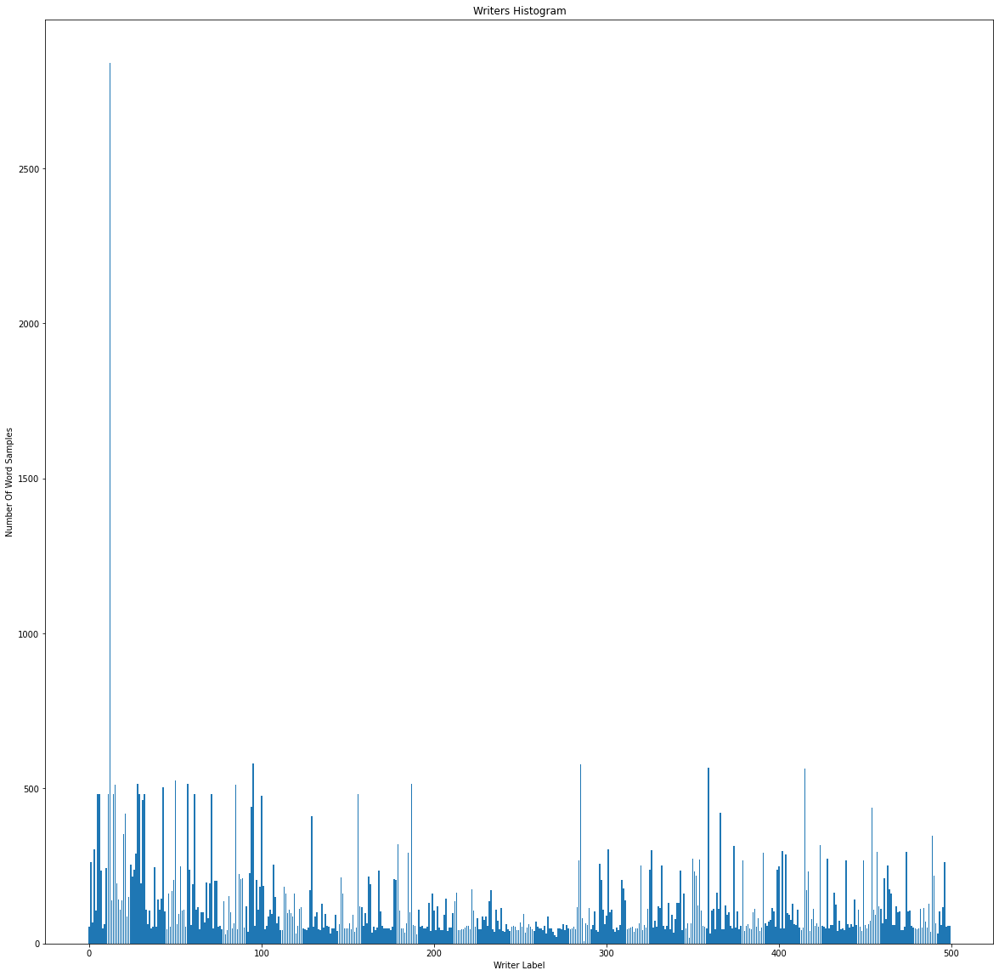

In [ ]:
plot_histogram(hist)

Imbalance verification: Plotting the histogram of the writer IDs with a relatively small amount of samples (50 word images maximum)

In [ ]:
hist_50max_thresh = histogram(labels, max_thresh=50)

The dataset is indeed imbalanced

In [ ]:
len(hist_50max_thresh)

132

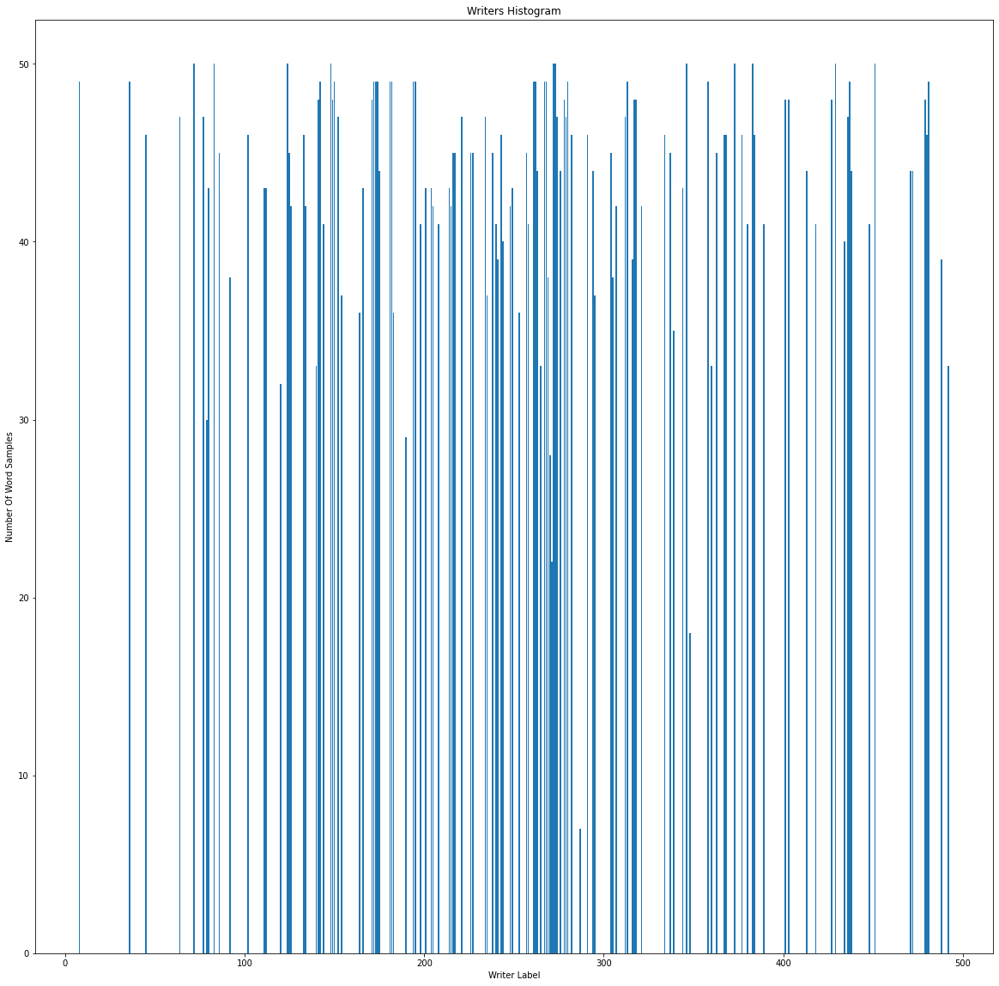

In [ ]:
plot_histogram(hist_50max_thresh)

Creating a more balanced histogram

In [ ]:
all_labels = get_labels(gt_path, 0, 1, [i for i in range(500)])

In [ ]:
balanced_hist = histogram(all_labels, 600, 200)

In [ ]:
len(balanced_hist)

88

In [ ]:
print(max(balanced_hist.values()), min(balanced_hist.values()))

582 201


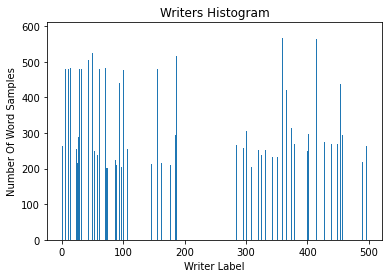

In [ ]:
plot_histogram(balanced_hist)

In [ ]:
def filter_gt_by_hist(hist, gt_path):
    with open(gt_path, 'r') as f_r, open(f"{gt_path.split('.')[0]}_{len(hist)}.txt", 'w') as f_w:
        gt_lines = f_r.readlines()
        labels = set(hist.keys())
        for line in tqdm(gt_lines):
            if wid2label[int(line.split(',')[0])] in labels:
                f_w.write(line)

In [ ]:
filter_gt_by_hist(balanced_hist, gt_path)

100%|██████████| 62855/62855 [00:00<00:00, 1168404.63it/s]


In [ ]:
all_balanced_labels = get_labels(f"{gt_path.split('.')[0]}_{len(balanced_hist)}.txt", 0, 1, [i for i in range(500)])

In [ ]:
balanced_hist = histogram(all_balanced_labels)

In [ ]:
print(list(balanced_hist.keys()))

[1, 3, 5, 6, 7, 10, 11, 14, 15, 20, 21, 24, 25, 26, 27, 28, 29, 31, 32, 38, 43, 49, 50, 53, 57, 58, 61, 71, 73, 74, 85, 87, 88, 89, 93, 94, 95, 97, 100, 107, 129, 146, 156, 162, 168, 177, 178, 179, 185, 187, 284, 285, 296, 297, 301, 309, 320, 325, 326, 332, 343, 350, 351, 352, 354, 359, 366, 374, 379, 391, 399, 400, 402, 404, 415, 417, 424, 428, 439, 449, 454, 457, 461, 463, 474, 489, 490, 496]


In [ ]:
len(all_balanced_labels)

28747

In [ ]:
print(max(balanced_hist.values()), min(balanced_hist.values()))

582 201


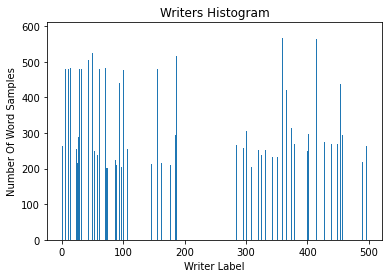

In [ ]:
plot_histogram(all_balanced_labels)

# A tradeoff between getting a bigger dataset and getting a more balanced one.
We chose writer IDs with range of (100, 800) samples. To do so, we changed our functions a bit. 

In [ ]:
def histogram(paths):
    # wid-text-uuid
    hist = dict()
    for p in paths:
        splitted = p.split('/')[-1].split('.')[0].split('-')
        wid = splitted[0]
        text = ''.join(splitted[1:-1])
        k = int(wid)
        if len(text) > 1:
            if k in hist.keys():
                hist[k].append(p)
            else:
                hist[k] = list()
    return hist


def filter_hist(hist, max_thresh=sys.maxsize*2+1, min_thresh=0):
    filtered_hist = dict()
    for k in hist.keys():
        if len(hist[k]) > min_thresh and len(hist[k]) < max_thresh:
            filtered_hist[k] = hist[k]
    return filtered_hist
    

def plot_histogram2(hist):
    fig = plt.figure()
    plt.rcParams["figure.figsize"] = (20, 20)
    hist_ = dict()
    for k in hist.keys():
        hist_[k] = len(hist[k])
    plt.bar(hist_.keys(), hist_.values())
    plt.xlabel("Writer Label")
    plt.ylabel("Number Of Word Samples")
    plt.title('Writers Histogram')
    plt.show()


def find_word_appearances(paths, sort=True):
    appearances = dict()
    for p in tqdm(paths):
        splitted = p.split('/')[-1].split('.')[0].split('-')
        wid = int(splitted[0])
        text = ''.join(splitted[1:-1])
        if appearances.get(text) is None:
            appearances[text] = [{ wid: 0 }]
        else:
            wid_indexes_by_text = [i for i in range(len(appearances[text])) if appearances[text][i].get(wid) is not None]
            if len(wid_indexes_by_text) == 0:
                appearances[text].append({ wid: 0 })
            else:
                appearances[text][wid_indexes_by_text[0]][wid] += 1
    if sort:
        appearances = { k: v for k, v in sorted(appearances.items(), key=lambda item: len(item[1]), reverse=True) }
    return appearances


def filter_paths_by_text(text_lst, paths):
    return [p for p in paths if ''.join(p.split('/')[-1].split('.')[0].split('-')[1:-1]) in text_lst]


def validate_words_per_wids(hist, N, words):
    """
    Checks if all wids has at least N samples of words, given a histogram
    """

    counter = 0
    wids = list(hist.keys())

    for w in tqdm(words):
        for wid in wids:
            paths = hist.get(wid)

            for p in paths:
                splitted = p.split('/')[-1].split('.')[0].split('-')
                text = ''.join(splitted[1:-1])
                if text == w:
                    counter += 1
                if counter == N:
                    break

            if counter < N:
                return False

    return True

In [ ]:
train_paths = glob(os.path.join(rfds_reals_dir, "real_train", "*"))
val_paths = glob(os.path.join(rfds_reals_dir, "real_val", "*"))
test_paths = glob(os.path.join(rfds_reals_dir, "real_test", "*"))
paths = train_paths+val_paths+test_paths
print(len(train_paths), len(val_paths), len(test_paths), len(paths))

77309 9769 9695 96773


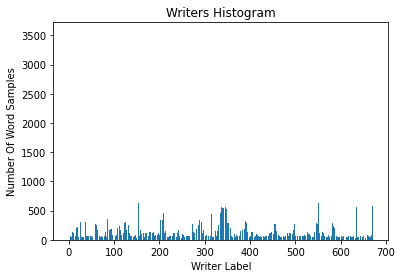

656


In [ ]:
hist = histogram(paths)
plot_histogram2(hist)
print(len(hist.keys()))

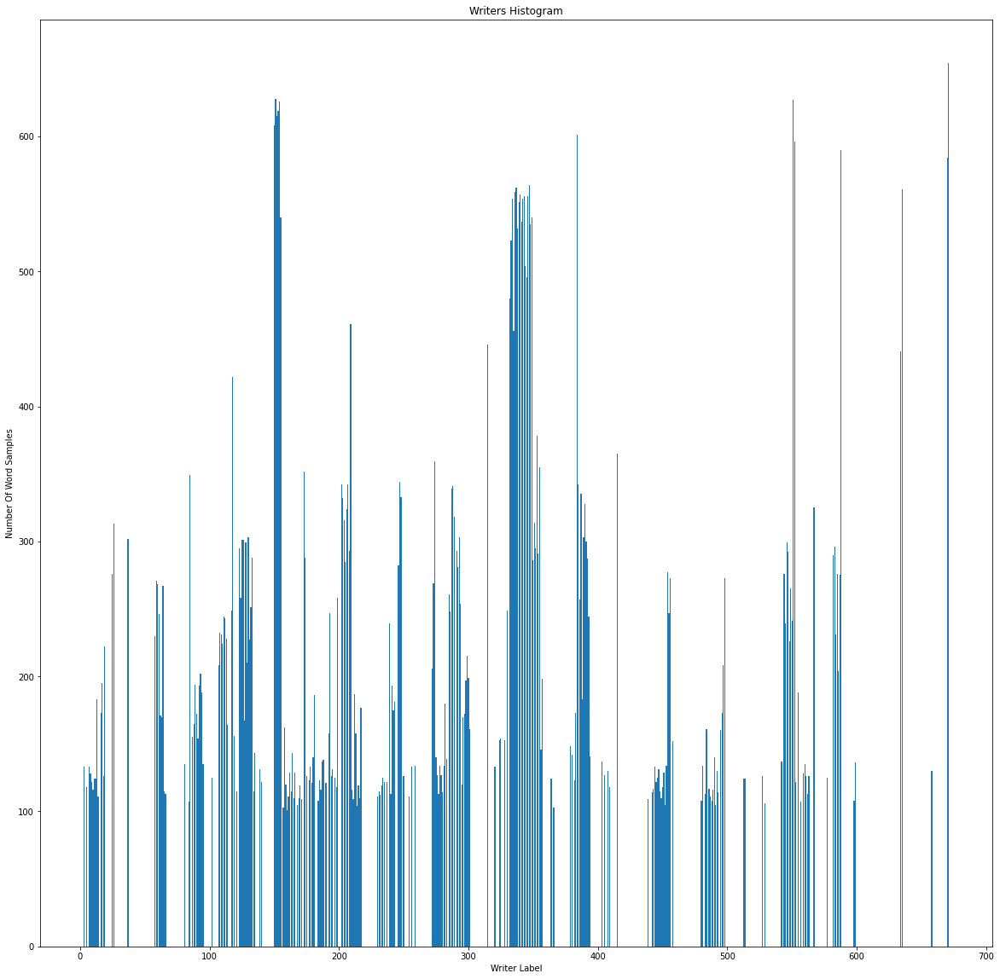

296


In [ ]:
filtered_hist = filter_hist(hist, max_thresh=800, min_thresh=100)
plot_histogram2(filtered_hist)
print(len(filtered_hist.keys()))

Save the new ground truth file as a JSON, representing the more balanced dataset than before

In [ ]:
with open("/content/WriterIdentification/filtered_paths_hist.json", 'w') as f:
    json.dump(filtered_hist, f)

In [ ]:
word_appearances = find_word_appearances(paths)
print(word_appearances)
print(word_appearances.keys())

100%|██████████| 96773/96773 [00:02<00:00, 33693.95it/s]

{'the': [{635: 26}, {209: 49}, {425: 2}, {137: 2}, {529: 6}, {25: 23}, {486: 8}, {530: 3}, {152: 45}, {184: 14}, {123: 12}, {0: 227}, {91: 12}, {212: 6}, {289: 27}, {59: 22}, {447: 10}, {186: 19}, {155: 39}, {49: 4}, {335: 25}, {391: 26}, {341: 28}, {40: 4}, {133: 20}, {555: 18}, {336: 30}, {154: 42}, {106: 5}, {58: 11}, {185: 10}, {343: 30}, {206: 17}, {279: 5}, {549: 15}, {357: 18}, {12: 3}, {577: 17}, {193: 14}, {236: 1}, {8: 12}, {601: 6}, {402: 10}, {524: 6}, {19: 16}, {90: 6}, {205: 22}, {204: 16}, {342: 29}, {647: 8}, {329: 5}, {200: 10}, {116: 6}, {275: 6}, {650: 2}, {385: 22}, {534: 3}, {548: 8}, {563: 6}, {89: 16}, {388: 10}, {153: 43}, {542: 8}, {441: 5}, {670: 54}, {390: 30}, {60: 14}, {475: 3}, {347: 30}, {525: 6}, {122: 2}, {291: 11}, {325: 11}, {296: 9}, {383: 7}, {415: 22}, {160: 5}, {494: 4}, {370: 3}, {33: 1}, {498: 17}, {367: 4}, {166: 2}, {389: 28}, {334: 30}, {345: 25}, {339: 31}, {588: 30}, {181: 13}, {567: 6}, {232: 14}, {304: 15}, {11: 8}, {95: 4}, {398: 6}, {29

10861 652 107 3297


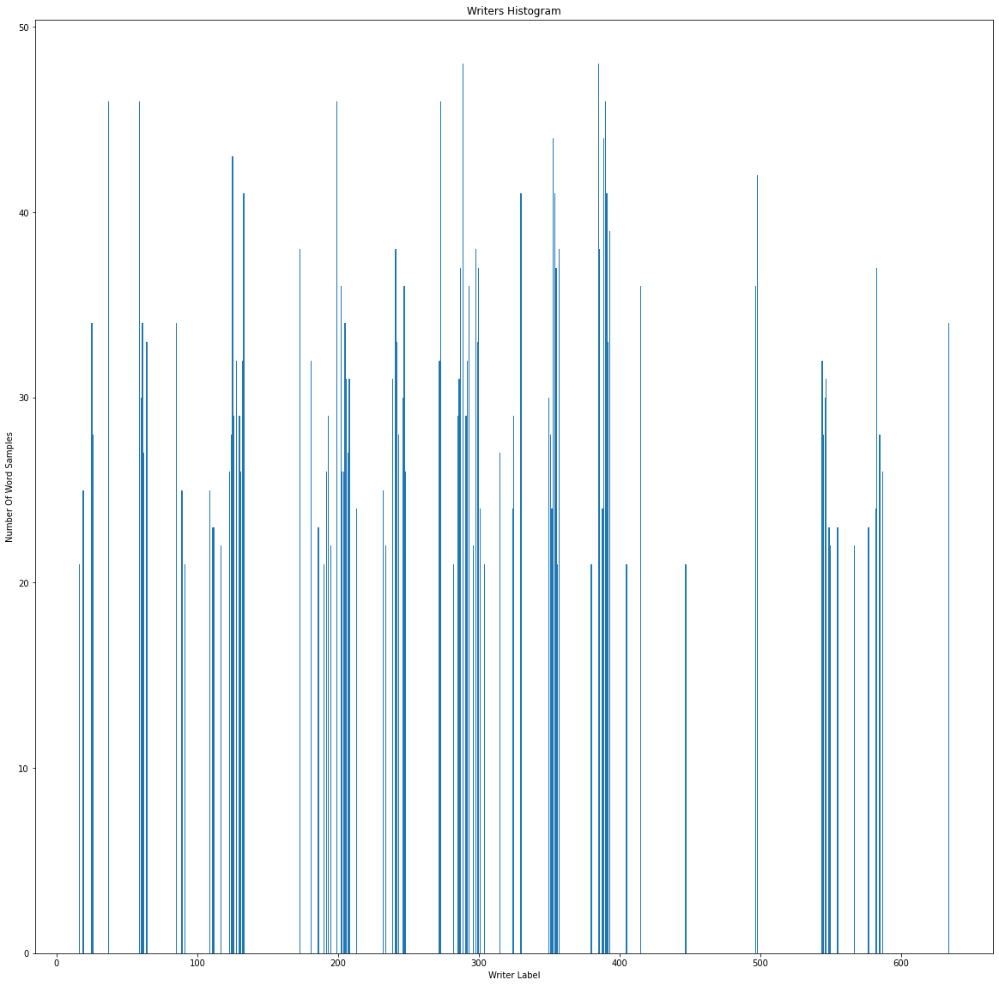

In [ ]:
common_words = ["the", "and", "for", "was", "with"]
common_text_paths = filter_paths_by_text(common_words, paths)
common_text_hist = histogram(common_text_paths)
filtered_common_text_hist = filter_hist(common_text_hist, max_thresh=50, min_thresh=20)
filtered_paths = list(itertools.chain.from_iterable(list(filtered_common_text_hist.values())))
print(len(common_text_paths), len(common_text_hist), len(filtered_common_text_hist), len(filtered_paths))
plot_histogram2(filtered_common_text_hist)

In [ ]:
validate_words_per_wids(filtered_common_text_hist, 2, common_words)

100%|██████████| 5/5 [00:00<00:00, 279.79it/s]


True

Save the new ground truth file as a JSON, representing a relatively balanced dataset of the most common words

In [ ]:
with open("/content/WriterIdentification/filtered_common_words_paths_hist.json", 'w') as f:
    json.dump(filtered_common_text_hist, f)

# Dataset Visualization
1 - target writer ID label

0 - any IAM dataset writer ID

One_VS_Rest_IAM dataset: A dataset for training a model to distinguish between a single IAM writer to everyone else in the IAM dataset.

In [ ]:
ovri_ds = One_VS_Rest_IAM(-1, json_path, "train", 0, 1, WIDTH, HEIGHT)
ovri_dl = D.DataLoader(ovri_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Target WID is 671 with 654 samples


Dataset Size = 1539
----------------------------


Label = 0


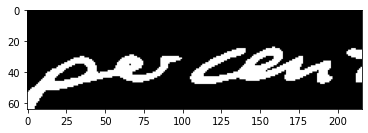


Label = 1


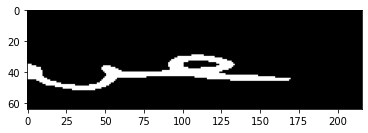


Label = 0


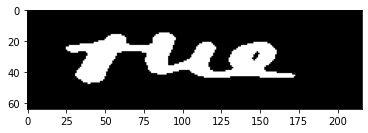


Label = 1


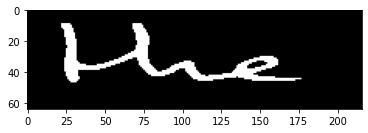


Label = 1


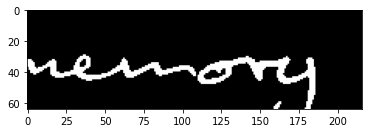


Label = 1


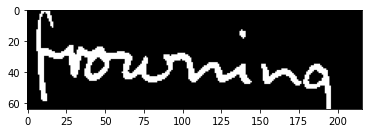


Label = 0


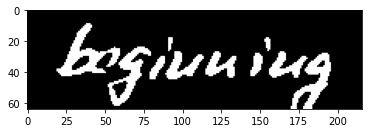


Label = 0


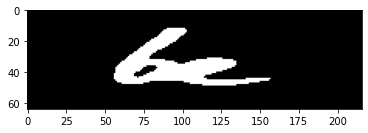

In [ ]:
print(f"Dataset Size = {len(ovri_ds)}\n----------------------------\n")
for x, y in ovri_dl:
    for i in range(8):
        print(f"\nLabel = {y[i].item()}")
        plt.imshow(x[i].squeeze(0), cmap='gray')
        plt.show()
    break

Two_Classes_Words dataset

In [ ]:
tcw_ds = Two_Classes_Words(None, None, json_path, "/content/eylonhand", "train", 0, 1, WIDTH, HEIGHT)
tcw_dl = D.DataLoader(tcw_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Dataset Size = 1035
----------------------------


Label = 1


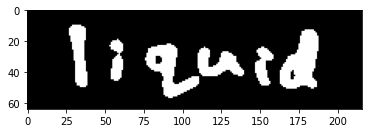


Label = 0


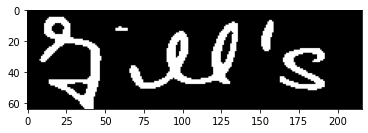


Label = 0


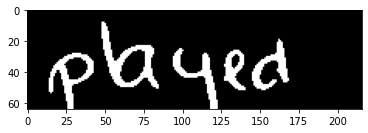


Label = 0


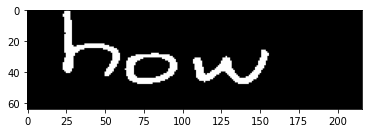


Label = 1


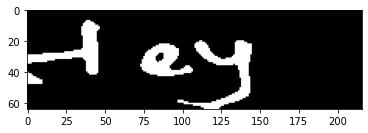


Label = 0


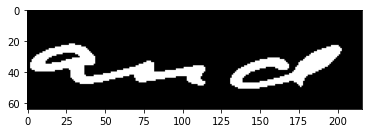


Label = 0


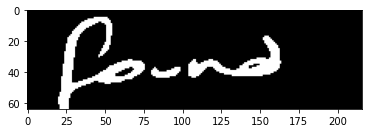


Label = 1


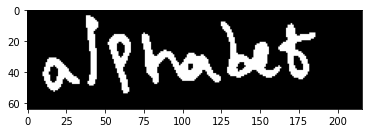

In [ ]:
print(f"Dataset Size = {len(tcw_ds)}\n----------------------------\n")
for x, y in tcw_dl:
    for i in range(8):
        print(f"\nLabel = {y[i].item()}")
        plt.imshow(x[i].squeeze(0), cmap='gray')
        plt.show()
    break

Siamese Dataset

In [ ]:
siamese_iam = SiameseDataset(None, None, json_path, our_hw_dir, "train", 0, 1, WIDTH, HEIGHT)
siamese_dl = D.DataLoader(siamese_iam, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Dataset Size = 886
----------------------------


Label = 1


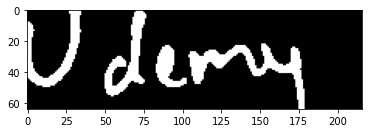


Label = 0


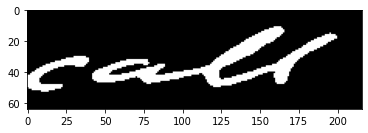


Label = 1


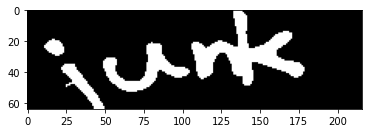


Label = 1


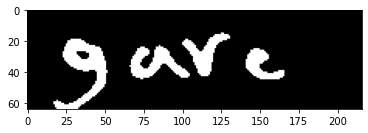


Label = 1


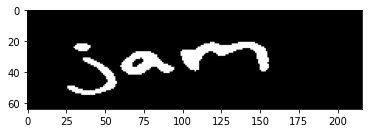


Label = 0


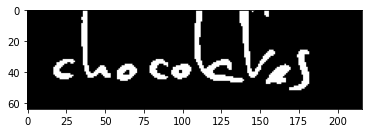


Label = 1


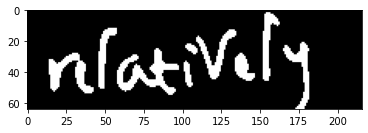


Label = 0


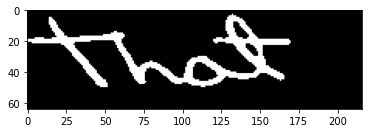

In [ ]:
print(f"Dataset Size = {len(siamese_iam)}\n----------------------------\n")
for tx, gx, ty, gy in siamese_dl:
    for i in range(8):
        print(f"\nLabel = {gy[i].item()}")
        plt.imshow(gx[i].squeeze(0), cmap='gray')
        plt.show()
    break

Siamese Dataset Version 2

In [ ]:
siamese_iam2 = SiameseDataset2("/content/WriterIdentification/filtered_common_words_paths_hist.json", "train", 0, 1, WIDTH, HEIGHT)
siamese_dl2 = D.DataLoader(siamese_iam2, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Dataset Size = 3297
----------------------------


Label = 1


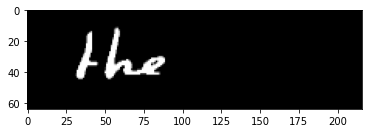


Label = 1


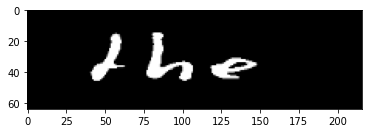


Label = 0


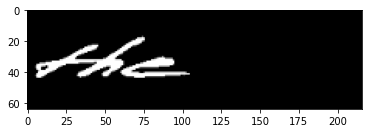


Label = 1


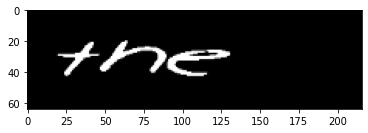


Label = 1


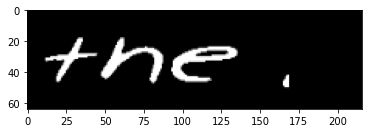


Label = 0


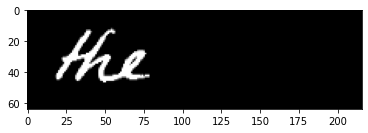


Label = 1


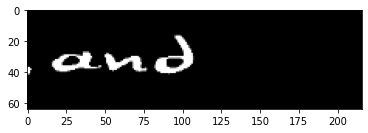


Label = 1


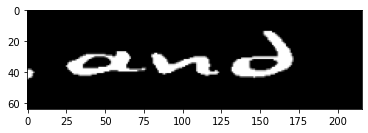


Label = 0


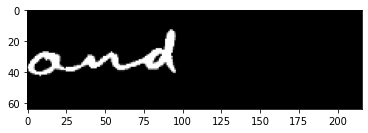


Label = 1


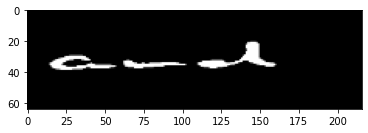


Label = 1


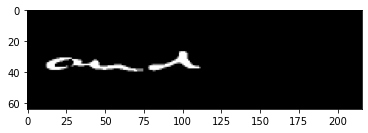


Label = 0


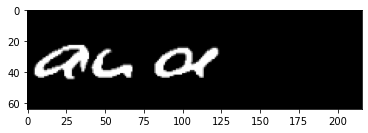

In [ ]:
print(f"Dataset Size = {len(siamese_iam2)}\n----------------------------\n")
for tx, sx, dx, sy, dy in siamese_dl2:
    for i in range(4):
        print(f"\nLabel = {sy[i].item()}")
        plt.imshow(tx[i].squeeze(0), cmap='gray')
        plt.show()
        print(f"\nLabel = {sy[i].item()}")
        plt.imshow(sx[i].squeeze(0), cmap='gray')
        plt.show()
        print(f"\nLabel = {dy[i].item()}")
        plt.imshow(dx[i].squeeze(0), cmap='gray')
        plt.show()
    break

# Training Process


In [ ]:
%cd "/content/WriterIdentification"

/content/WriterIdentification


Training on the One_VS_Rest IAM dataset: Training a resnet50 model to distinguish between the writer with the largest amount of samples (654 samples) to everyone else in the balanced IAM dataset (296 writer IDs).

In [ ]:
!python3 main.py -c "/content/WriterIdentification/configs/resnet_train_iam_target_cfg.yaml"

Training with augmentations on the Two_Classes_Words dataset: Training a resnet50 model to distinguish between IAM words (balanced -> 296 writer IDs) to our handwriting (roughly 443 samples for each class).

In [ ]:
!python3 main.py -c "/content/WriterIdentification/configs/resnet_train_siamese_israeli_target_aug_cfg.yaml"

The same training process with augmentations as above (balanced IAM), but using a Siamese architecture, based on a couple of resnet50 backbones.

In [ ]:
!python3 main.py -c "/content/WriterIdentification/configs/resnet_train_israeli_target_aug_cfg.yaml"

Training on the balanced IAM dataset without augmentations, the same architectures from above.

In [ ]:
!python3 main.py -c "/content/WriterIdentification/configs/resnet_train_siamese_israeli_target_cfg.yaml"

In [ ]:
!python3 main.py -c "/content/WriterIdentification/configs/resnet_train_israeli_target_cfg.yaml"

Training on the balanced IAM common words dataset with augmentations, the same siemese architecture.

In [ ]:
!python3 main_siamese_expr2.py -c "/content/WriterIdentification/configs/resnet_train_siamese_israeli_target_cfg2.yaml"

Training on the balanced IAM common words dataset with augmentations, the architecture from the SigNet paper.

In [ ]:
!python3 main_siamese_expr2.py -c "/content/WriterIdentification/configs/resnet_train_siamese_israeli_target_cfg2.yaml"

# Metrics Results

In [ ]:
names = ["train_batch_loss", "train_batch_accuracy", "train_batch_precision", \
"train_batch_recall", "train_batch_f_measure", "train_batch_tp", "train_batch_tn", \
"train_batch_fp", "train_batch_fn", "val_accuracy", "val_precision", "val_recall", \
"val_f_measure", "val_tp", "val_tn", "val_fp", "val_fn"]

Resnet50 without augmentations (a single writer ID against the others)

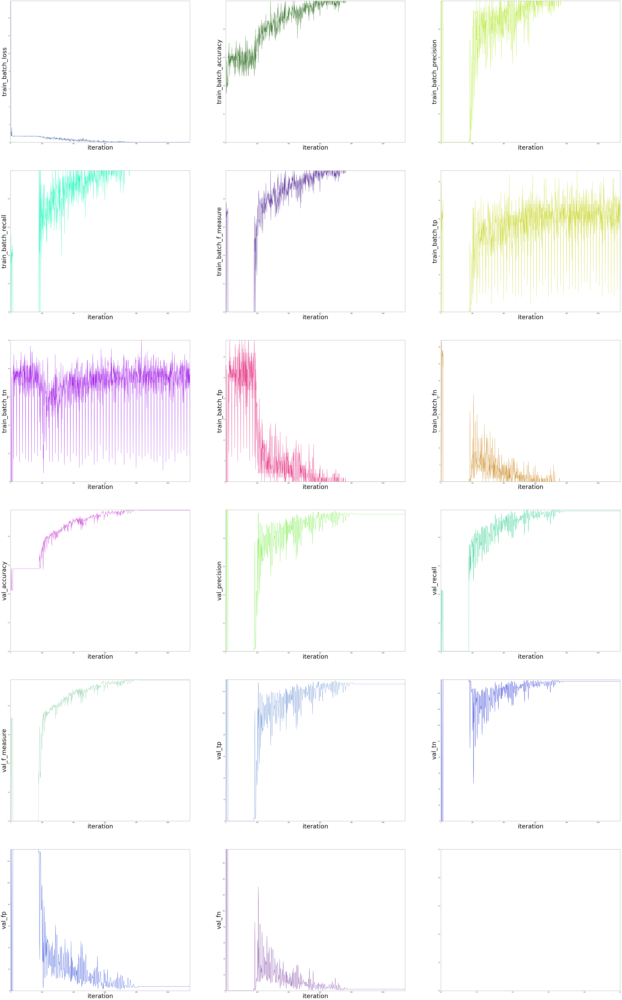

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/iam_target/metrics_target.txt"
plot_stats(metrics_path, names)

Resnet50 without augmentations (our handwriting ID against the others from balanced IAM) without augmentations

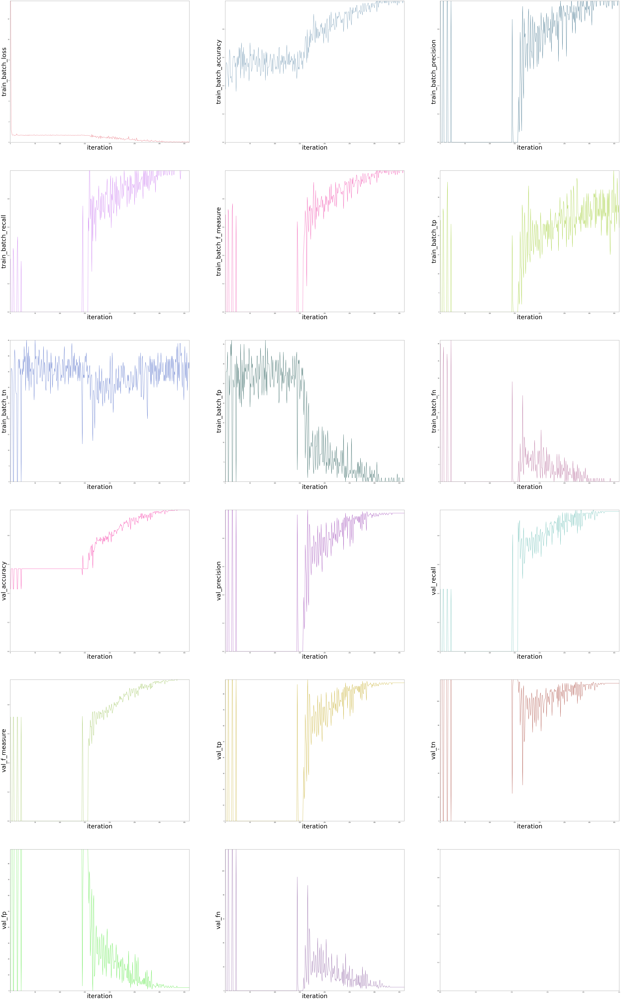

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target/metrics_target.txt"
plot_stats(metrics_path, names)

Resnet50 with augmentations (our handwriting ID against the others from balanced IAM)

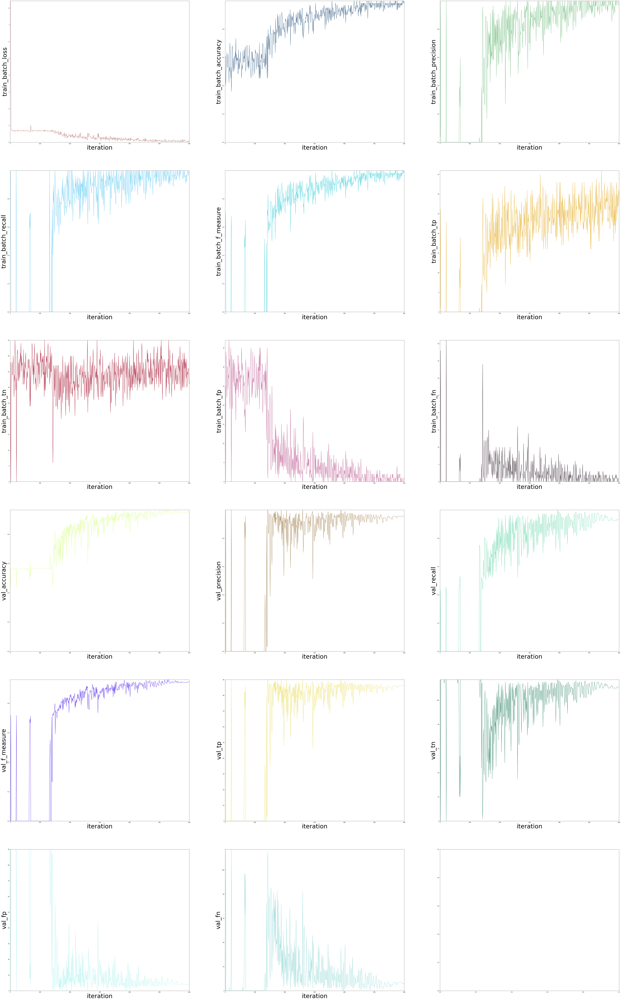

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_aug/metrics_target.txt"
plot_stats(metrics_path, names)

Siamese NN architecture without augmentations (our handwriting ID against the others from balanced IAM)

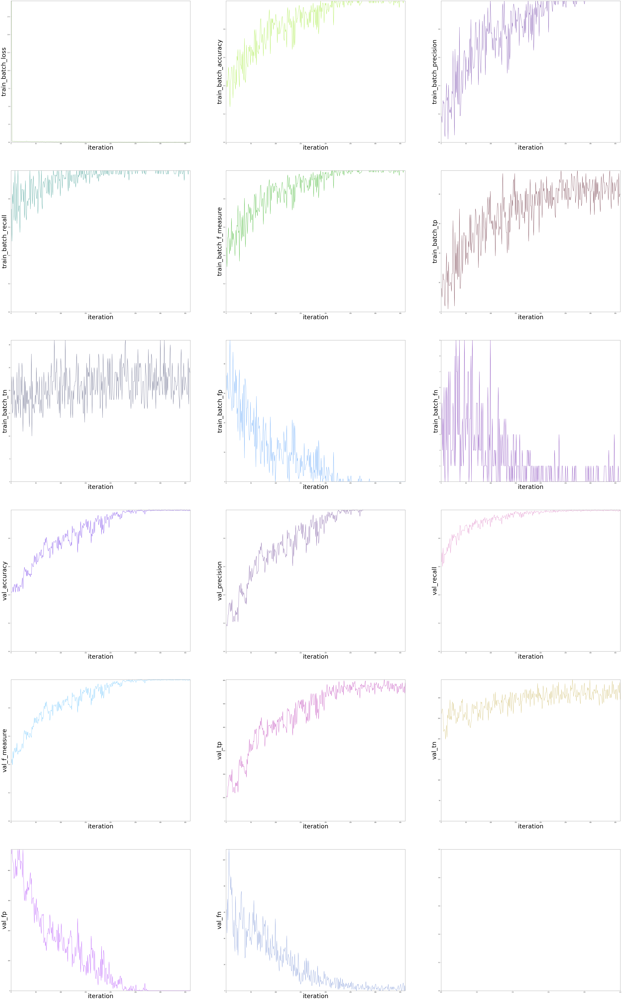

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_siamese/metrics_target.txt"
plot_stats(metrics_path, names)

Siamese NN architecture with augmentations (our handwriting ID against the others from balanced IAM)

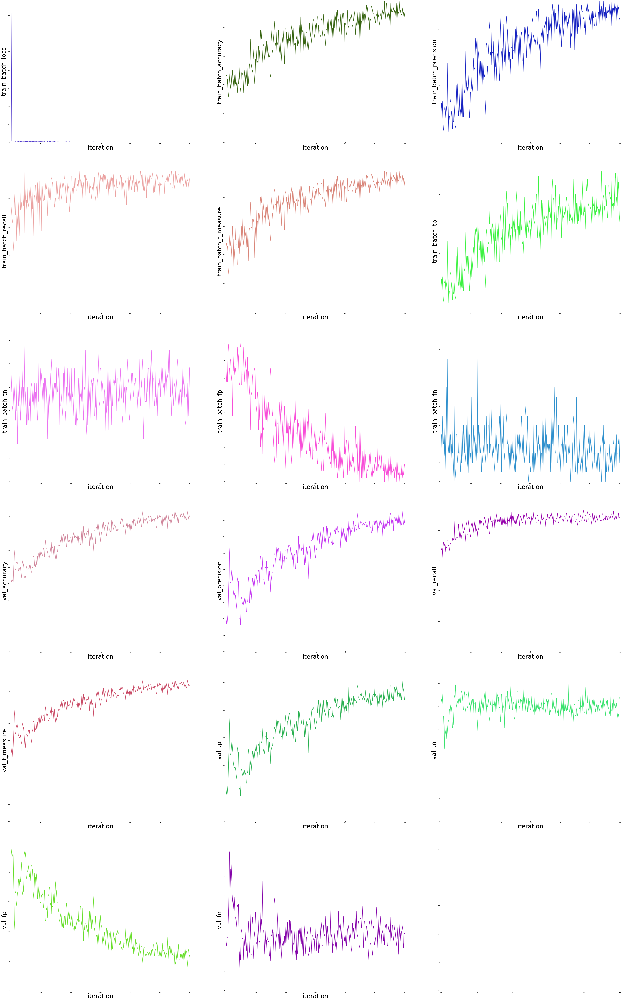

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_siamese_aug/metrics_target.txt"
plot_stats(metrics_path, names)

Resnet50 without augmentations (a single writer ID against the others)

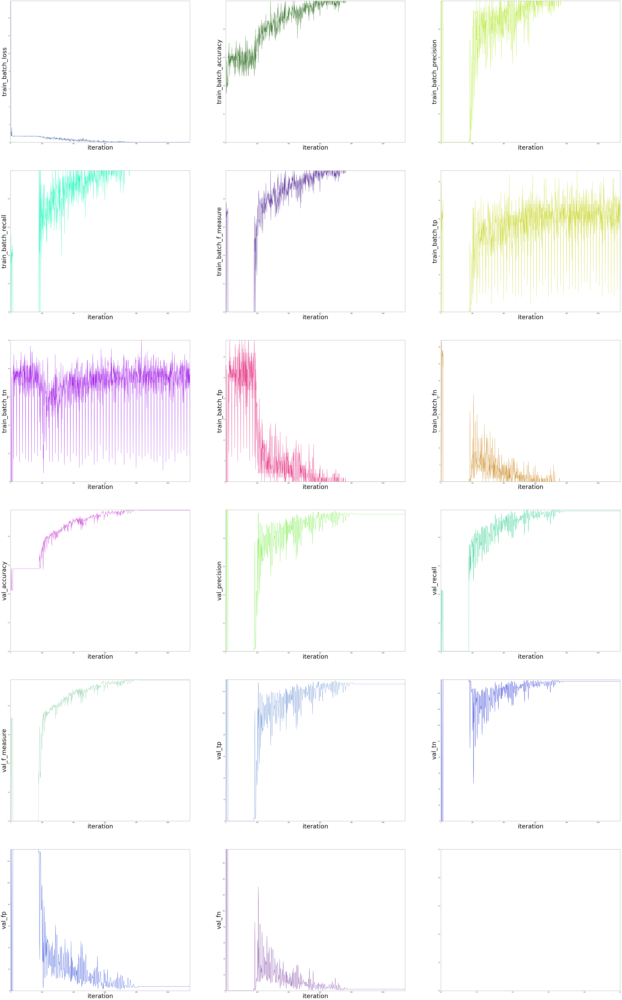

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/iam_target/metrics_target.txt"
plot_stats(metrics_path, names)

Siamese NN architecture that was trained on a dataset containig word clusters of the same content. The purpose is to identify whether a couple of images share the same writer ID.

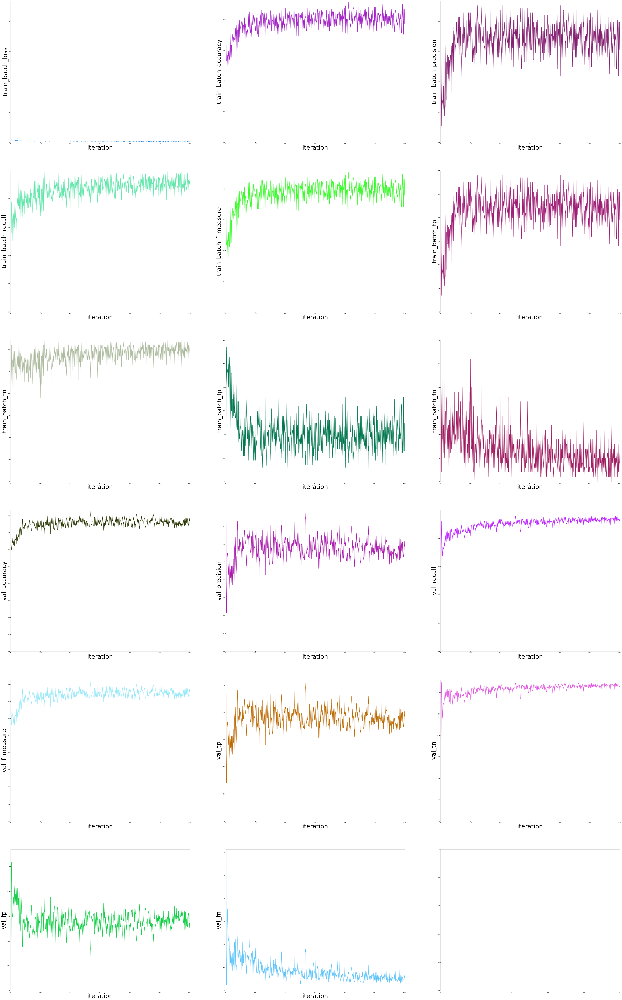

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_siamese_aug2/metrics_target.txt"
plot_stats(metrics_path, names)

The SigNet architecture, trained on a dataset containig word clusters of the same content. The purpose is to identify whether a couple of images share the same writer ID.

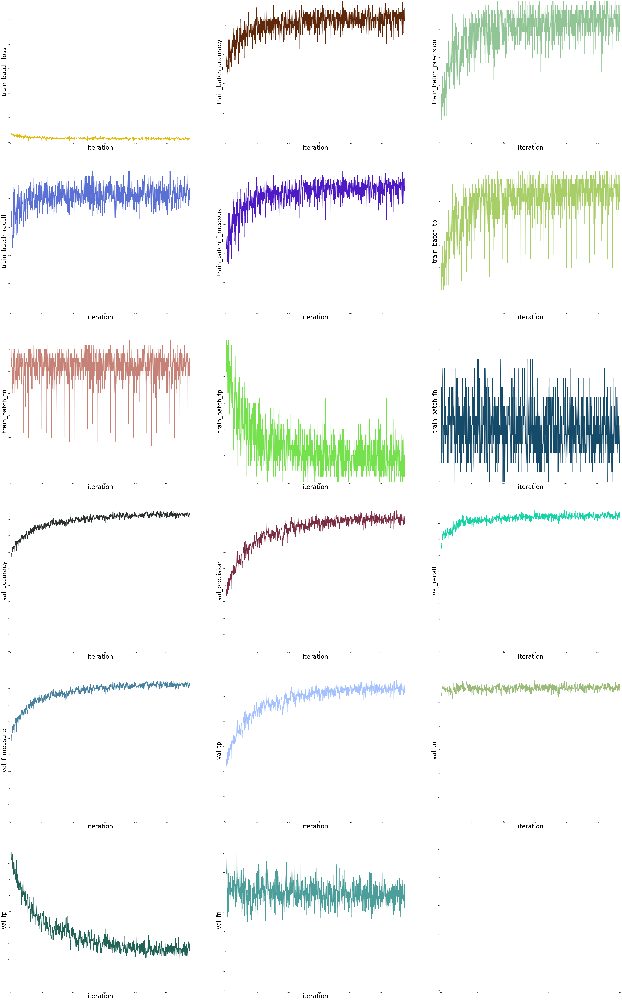

In [ ]:
metrics_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_siamese_aug3/metrics_target.txt"
plot_stats(metrics_path, names)

# Testing our models against israeli handwritten word images

Test Dataloaders

In [ ]:
target_paths = glob(os.path.join(our_hw_dir, '*'))
infer_paths = glob(os.path.join(israeli_hw_dir, '*'))
infer_labels = [0 for ip in infer_paths]

In [ ]:
classic_ds = Classic_DS(infer_paths, infer_labels)
classic_dl = D.DataLoader(classic_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Dataset Size = 783
----------------------------


Label = 0


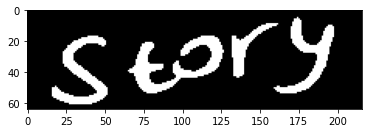


Label = 0


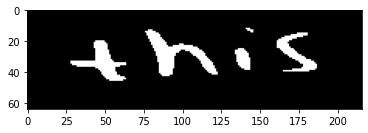


Label = 0


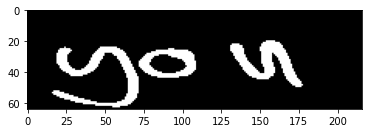


Label = 0


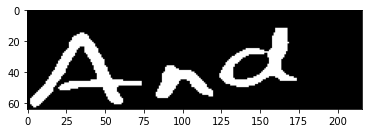


Label = 0


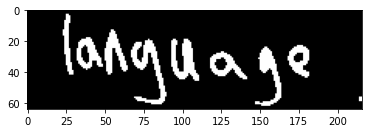


Label = 0


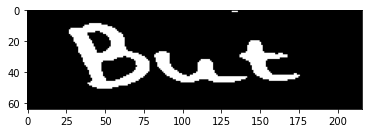


Label = 0


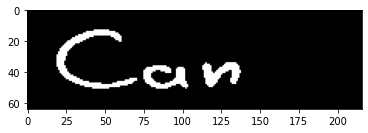


Label = 0


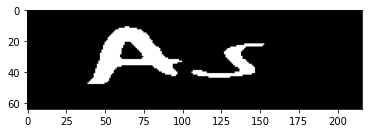

In [ ]:
print(f"Dataset Size = {len(classic_ds)}\n----------------------------\n")
for x, y in classic_dl:
    for i in range(BATCH_SIZE):
        print(f"\nLabel = {y[i].item()}")
        plt.imshow(x[i].squeeze(0), cmap='gray')
        plt.show()
    break

In [ ]:
siamese_ds = Classic_Siamese_DS(target_paths, infer_paths, infer_labels)
siamese_dl = D.DataLoader(siamese_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Dataset Size = 783
----------------------------


Label = 0


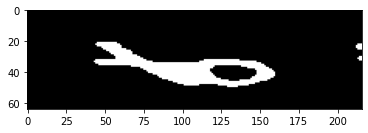


Label = 0


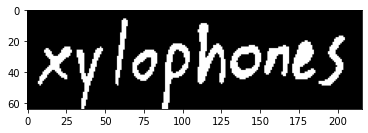


Label = 0


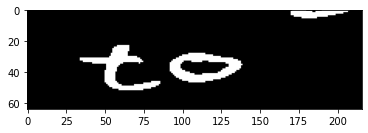


Label = 0


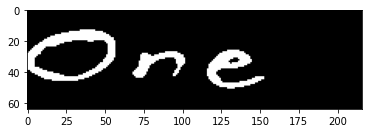


Label = 0


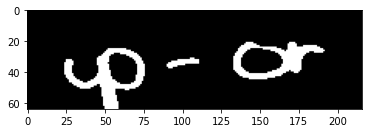


Label = 0


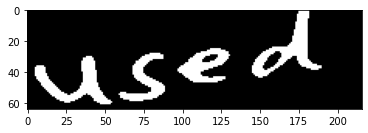


Label = 0


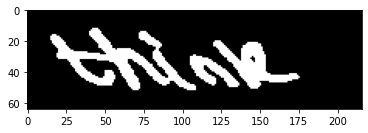


Label = 0


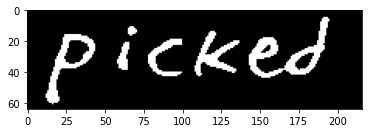

In [ ]:
print(f"Dataset Size = {len(siamese_ds)}\n----------------------------\n")
for _, x, _, y in siamese_dl:
    for i in range(BATCH_SIZE):
        print(f"\nLabel = {y[i].item()}")
        plt.imshow(x[i].squeeze(0), cmap='gray')
        plt.show()
    break

Loading and testing the models

In [ ]:
def resnet_identifier(checkpoint_path):
    backbone = torchvision.models.resnet50(pretrained=False)
    backbone = torch.nn.Sequential(*(list(backbone.children())[1:-1]))
    flatten = nn.Flatten(1, 3)
    conv_head_lst = [nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)]
    fc_tail_lst = [nn.Linear(in_features=2048, out_features=1024, bias=True),
                                nn.Linear(in_features=1024, out_features=NUM_CLASSES, bias=True)]
    model = ConvNet(backbone, fc_tail_lst, conv_head_lst, flatten)
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    return model

In [ ]:
def siamese_identifier(checkpoint_path, is_signet=False):
    model = SiameseResnet(1, NUM_CLASSES) if not is_signet else SigNet()
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    return model

Test resnet50 writer identification model with a target writer from the IAM dataset

In [ ]:
checkpoint_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/iam_target/target_identifier-e60.pt"
model = resnet_identifier(checkpoint_path)
model = model.to(device)
model.eval();

In [ ]:
acc, precision, recall, f_measure, TP, TN, FP, FN = get_all_metrics(model, classic_dl, device)
print(f"Metrics:\n\nAccuracy = {acc}\nPrecision = {precision}\nRecall = {recall}\nF-Measure (F1) = {f_measure}\nTP = {TP}\nTN = {TN}\nFP = {FP}\nFN = {FN}")

Metrics:

Accuracy = 0.9259258076723107
Precision = 0.0
Recall = 0.0
F-Measure (F1) = 0.0
TP = 0
TN = 725
FP = 0
FN = 58


Test resnet50 writer identification model with an israeli target (our handwriting)

In [ ]:
checkpoint_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_aug/target_identifier-e60.pt"
model = resnet_identifier(checkpoint_path)
model = model.to(device)
model.eval();

In [ ]:
acc, precision, recall, f_measure, TP, TN, FP, FN = get_all_metrics(model, classic_dl, device)
print(f"Metrics:\n\nAccuracy = {acc}\nPrecision = {precision}\nRecall = {recall}\nF-Measure (F1) = {f_measure}\nTP = {TP}\nTN = {TN}\nFP = {FP}\nFN = {FN}")

Metrics:

Accuracy = 0.6998721966957604
Precision = 0.0
Recall = 0.0
F-Measure (F1) = 0.0
TP = 0
TN = 548
FP = 0
FN = 235


Test the siamese writer identification model on our handwriting as the target writer

In [ ]:
checkpoint_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_siamese_aug/target_identifier-e40.pt"
model = siamese_identifier(checkpoint_path)
model = model.to(device)
for p in model.parameters():
    p.requires_grad = False
model.eval();

In [ ]:
acc, precision, recall, f_measure, TP, TN, FP, FN = get_all_metrics(model, siamese_dl, device, is_siamese=True)
print(f"Metrics:\n\nAccuracy = {acc}\nPrecision = {precision}\nRecall = {recall}\nF-Measure (F1) = {f_measure}\nTP = {TP}\nTN = {TN}\nFP = {FP}\nFN = {FN}")

Metrics:

Accuracy = 0.7471263413631748
Precision = 0.0
Recall = 0.0
F-Measure (F1) = 0.0
TP = 0
TN = 585
FP = 0
FN = 198


Test the siamese writer identification model version 2, trained to distinguish whether two words of the same content was written by the same writer

In [ ]:
checkpoint_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_siamese_aug2_fixed/target_identifier-e60.pt"
model = siamese_identifier(checkpoint_path)
for p in model.parameters():
    p.requires_grad = False
model.eval();

In [ ]:
def find_optimal_thresholds(model):
    text_lst = ["the", "and"]

    negative_the_paths = glob(os.path.join("/content/negative_the", "*"))
    negative_and_paths = glob(os.path.join("/content/negative_and", "*"))
    negative_paths_by_content = [negative_the_paths, negative_and_paths]

    positive_paths = glob(os.path.join("/content/posotives_cropped", "*"))
    positive_the_paths = [p for p in positive_paths if "the" in p]
    positive_and_paths = [p for p in positive_paths if "and" in p]
    positive_paths_by_content = [positive_the_paths, positive_and_paths]

    yp = torch.tensor(1).long().to(device)
    yn = torch.tensor(0).long().to(device)

    best_thresholds = [0.5, 0.5]


    for i in range(len(text_lst)):
        pp_by_content_i, np_by_content_i = positive_paths_by_content[i], negative_paths_by_content[i]
        best_f1 = 0.0
        
        for ti in tnrange(50, 80, 1):
            thresh = ti / 100
            tp, tn, fp, fn = 0, 0, 0, 0

            for pi in range(len(pp_by_content_i)):
                xp = cv2.imread(pp_by_content_i[pi], 0)
                xp = test_preprocess(xp)
                xp = torch.from_numpy(xp).unsqueeze(0).unsqueeze(0).float().to(device)

                # Positives
                for pi_ in range(len(pp_by_content_i)):
                    if pi == pi_:
                        continue

                    xp_ = cv2.imread(pp_by_content_i[pi_], 0)
                    xp_ = test_preprocess(xp_)
                    xp_ = torch.from_numpy(xp_).unsqueeze(0).unsqueeze(0).float().to(device)

                    dist = model(xp, xp_)
                    pred = torch.sigmoid(dist)

                    if pred < thresh:
                        tp += 1
                    else:
                        fp += 1
              
                # Negatives
                for ni in range(len(np_by_content_i)):
                    xn = cv2.imread(np_by_content_i[ni], 0)
                    xn = test_preprocess(xn)
                    xn = torch.from_numpy(xn).unsqueeze(0).unsqueeze(0).float().to(device)

                    dist = model(xp, xn)
                    pred = torch.sigmoid(dist)

                    if pred > thresh:
                        tn += 1
                    else:
                        fn += 1
                        
            precision = tp / (tp + fp + 1e-4)
            recall = tp / (tp + fn + 1e-4)
            f1 = 0.5 * precision + 0.5 * recall
            print(f"Current values: threshold = {thresh}, F1 = {f1}, best F1 = {best_f1}, thresholds = {best_thresholds}")
            if f1 > best_f1:
                best_thresholds[i] = thresh
                best_f1 = f1

    return best_thresholds

In [ ]:
def siamese_infer(model, thresholds):

    text_lst = ["the", "and"]
    infer_paths = glob(os.path.join("/content/target_cropped", "*"))
    tp, tn, fp, fn = 0, 0, 0, 0
    counter = 0

    positive_paths = glob(os.path.join("/content/posotives_cropped", "*"))
    positive_the_paths = [p for p in positive_paths if "the" in p]
    positive_and_paths = [p for p in positive_paths if "and" in p]
    positive_paths_by_content = [positive_the_paths, positive_and_paths]

    for ip in infer_paths:
        if text_lst[0] in ip:
            counter += 1
            xi = cv2.imread(ip, 0)
            xi = test_preprocess(xi)
            xi = torch.from_numpy(xi).unsqueeze(0).unsqueeze(0).float().to(device)
            
            xp = cv2.imread(random.sample(positive_paths_by_content[0], 1)[0], 0)
            xp = test_preprocess(xp)
            xp = torch.from_numpy(xp).unsqueeze(0).unsqueeze(0).float().to(device)
      
            dist = model(xp, xi)
            pred = torch.sigmoid(dist)
            if pred < thresholds[0]:
                tp += 1
            else:
                fp += 1

        if text_lst[1] in ip:
            counter += 1
            xi = cv2.imread(ip, 0)
            xi = test_preprocess(xi)
            xi = torch.from_numpy(xi).unsqueeze(0).unsqueeze(0).float().to(device)
            
            xp = cv2.imread(random.sample(positive_paths_by_content[1], 1)[0], 0)
            xp = test_preprocess(xp)
            xp = torch.from_numpy(xp).unsqueeze(0).unsqueeze(0).float().to(device)

            dist = model(xp, xi)
            pred = torch.sigmoid(dist)
            if pred < thresholds[1]:
                tp += 1
            else:
                fp += 1
            
    print(f"Accuracy = {tp / counter}")

In [ ]:
best_thresholds = find_optimal_thresholds(model)

In [ ]:
print(best_thresholds)

[0.68, 0.63]


In [ ]:
siamese_infer(model, best_thresholds)

Accuracy = 0.9


The same test as siamese version 2, but with the architecture from the paper SigNet

In [ ]:
checkpoint_path = "/content/drive/MyDrive/Final Project/Models/WriterIdentification/israeli_target_siamese_aug3/target_identifier-e60.pt"
model = siamese_identifier(checkpoint_path, True)
model = model.to(device)
for p in model.parameters():
    p.requires_grad = False
model.eval();

In [ ]:
best_thresholds = find_optimal_thresholds(model)

In [ ]:
print(best_thresholds)

[0.73, 0.65]


In [ ]:
siamese_infer(model, best_thresholds)

Accuracy = 0.9


# Conclusions
The models that were trained to distinguish between our handwriting style and the IAM handwriting styles produced a lot of mistakes in the test process against other writers from the same ethnic group. In contrast, the model that was trained solely on the IAM dataset produced high metric scores as it is not familiar with the handwriting of writers with different ethnicity, which derives from another data distribution that differs from its target IAM writer. Hence, The ethnicity of the dataset writers is a significant set of features in the scope of Writer Identification.
It is possible to create models that are trained to tell whether two handwriting samples are different or not, as the Siamese architecture, without focusing on the ethnicity.